In [24]:
from pystac_client import Client
import matplotlib.pyplot as plt
import matplotlib
import pandas as pd
import numpy as np
import hvplot.xarray
from hvplot import hvPlot
import xarray as xr
import rioxarray as rxr
import stackstac
import h5py 
import os
import datetime
import geopandas as gpd
import folium
import folium.plugins
from folium.plugins import MousePosition
import cartopy.crs as ccrs
import cartopy.feature as cf
import cartopy.io.img_tiles as cimgt
import requests
import surfaceAreaGrid
from geopy import geocoders
# For reading COG to xarray
import stackstac
# For displaying image in a jupyter notebook
from IPython.display import Image, display
# For reading from S3 bucket
import boto3
pd.options.plotting.backend = 'holoviews'

<h1>Intro: Explore GRA2PES Dataset in the STAC Catalog</h1>

In [25]:
stac_api_url = "http://earth.gov/ghgcenter/api/stac/"

In [32]:
# Open catalog, print info and available collections
catalog = Client.open(stac_api_url)
# print catalog and collections titles
print('>> Title: ',catalog.title)
print('>> Collections:')
for collection in catalog.get_collections():
    print(collection.id)

>> Title:  US GHG Center STAC API
>> Collections:
ct-ch4-monthgrid-v2023
emit-ch4plume-v1
lpjwsl-wetlandch4-monthgrid-v1
vulcan-ffco2-yeargrid-v4
goes-ch4plume-v1
odiac-ffco2-monthgrid-v2023
tm54dvar-ch4flux-monthgrid-v1
lpjeosim-wetlandch4-monthgrid-v2
gosat-based-ch4budget-yeargrid-v2
lpjeosim-wetlandch4-daygrid-v2
gra2pes-ghg-monthgrid-v1
gosat-based-ch4budget-yeargrid-v1
micasa-carbonflux-daygrid-v1
sedac-popdensity-yeargrid5yr-v4.11
vulcan-ffco2-elc-res-yeargrid-v4
tm54dvar-ch4flux-mask-monthgrid-v1
casagfed-carbonflux-monthgrid-v3
micasa-carbonflux-monthgrid-v1
lpjeosim-wetlandch4-daygrid-v1
lpjeosim-wetlandch4-monthgrid-v1
oco2geos-co2-daygrid-v10r
epa-ch4emission-yeargrid-v2express
lpjwsl-wetlandch4-daygrid-v1
oco2-mip-meanco2budget-yeargrid-v1
oco2-mip-co2budget-yeargrid-v1
eccodarwin-co2flux-monthgrid-v5
odiac-ffco2-monthgrid-v2022


In [33]:
# Select GRA2PES collection: browse item_assets, spatial and temporal extent
collection = catalog.get_collection('gra2pes-ghg-monthgrid-v1')
collection

<CollectionClient id=gra2pes-ghg-monthgrid-v1>

In [34]:
# Get items from this collection, examine temporal extent of each
items = collection.get_items()
for item in items:
    print(item)

<Item id=gra2pes-ghg-monthgrid-v1-202112>
<Item id=gra2pes-ghg-monthgrid-v1-202111>
<Item id=gra2pes-ghg-monthgrid-v1-202110>
<Item id=gra2pes-ghg-monthgrid-v1-202109>
<Item id=gra2pes-ghg-monthgrid-v1-202108>
<Item id=gra2pes-ghg-monthgrid-v1-202107>
<Item id=gra2pes-ghg-monthgrid-v1-202106>
<Item id=gra2pes-ghg-monthgrid-v1-202105>
<Item id=gra2pes-ghg-monthgrid-v1-202104>
<Item id=gra2pes-ghg-monthgrid-v1-202103>
<Item id=gra2pes-ghg-monthgrid-v1-202102>
<Item id=gra2pes-ghg-monthgrid-v1-202101>


In [35]:
# Explore one item (one month!): Check out properties, assets
item = collection.get_item('gra2pes-ghg-monthgrid-v1-202112')
item

<Item id=gra2pes-ghg-monthgrid-v1-202112>

# Science topic: Compare GHG seasonal cycles from two cities

Let's compare CO2 emissions over the course of a year from two cities in different regions - for example, Chicago and Atlanta.

<h2>Read data from STAC into xarray Dataset</h2>

In [36]:
search = catalog.search(
    collections='gra2pes-ghg-monthgrid-v1',
    datetime=['2021-01-01T00:00:00Z','2021-12-31T00:00:00Z']
)
# Take a look at the items we found
for item in search.item_collection():
    print(item)

<Item id=gra2pes-ghg-monthgrid-v1-202112>
<Item id=gra2pes-ghg-monthgrid-v1-202111>
<Item id=gra2pes-ghg-monthgrid-v1-202110>
<Item id=gra2pes-ghg-monthgrid-v1-202109>
<Item id=gra2pes-ghg-monthgrid-v1-202108>
<Item id=gra2pes-ghg-monthgrid-v1-202107>
<Item id=gra2pes-ghg-monthgrid-v1-202106>
<Item id=gra2pes-ghg-monthgrid-v1-202105>
<Item id=gra2pes-ghg-monthgrid-v1-202104>
<Item id=gra2pes-ghg-monthgrid-v1-202103>
<Item id=gra2pes-ghg-monthgrid-v1-202102>
<Item id=gra2pes-ghg-monthgrid-v1-202101>


In [37]:
# Read data into an xarray Dataset
ds = stackstac.stack(search.item_collection(),epsg=4326).squeeze()

Quick interactive map to explore the data a little bit...

In [69]:
# For now, focus on CO2
# Later, you can change <band> to whichever species you like: co2, co, nox, so2, pm2.5, and repeat the analysis for another gas!
# You will likely have to change the colorbar range to correspond to the cocnentrations of a different gas.
band='co2'
# Set min and max values for colorbar
vmin = 0
vmax = 2000
# Set colormap of choice
cmap = 'Spectral_r'
# Generate map
ds.sel(band=band)[9,:,:].hvplot(x='x',y='y',cmap=cmap,coastline=True,clim=(vmin,vmax))

:Overlay
   .Image.I     :Image   [x,y]   (stackstac-a1085b5985261f61e4c7df190b046952)
   .Coastline.I :Feature   [Longitude,Latitude]

In [12]:
# Take a look at the dimensions of the data
print(ds.sel(band=band).shape)
print(ds.sel(band=band).dims)

(12, 947, 2188)
('time', 'y', 'x')


<h2> Select Areas Of Interest (AOIs) using GEOJSON shapes and rioxarray</h2>

<h3>Read in AOIs</h3>

GEOJSONs generated via geojson.io. You can create your own and drag + drop them into this directory to look at any AOIs you'd like.

In [70]:
aoi1 = gpd.read_file('./data/chicagoland.geojson').to_crs(epsg=4326)
name1 = 'Chicago'
aoi2 = gpd.read_file('./data/atlanta.geojson').to_crs(epsg=4326)
name2 = 'Atlanta'

Let's view them on a map!

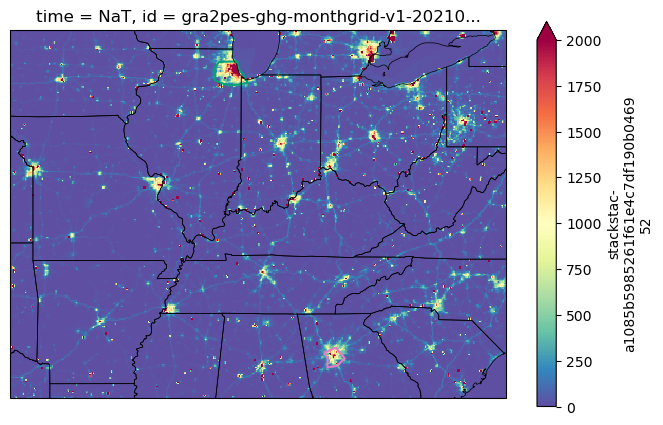

In [71]:
import cartopy.feature as cf
cmap='Spectral_r'    # colormap definition
fig1=plt.figure(figsize=(8,5))
ax1 = fig1.add_subplot(projection=ccrs.PlateCarree())
# Add our data layer
# We can reuse our vmin, vmax, cmap from the previous section
p1 = ds.sel(band=band)[9,:,:].plot(vmin=vmin,vmax=vmax,cmap=cmap,ax=ax1)
# Now let's draw the shapes of our AOIs
# Shape 1 is green
color1 = '#00A676'
# Shape 2 is pink
color2 = '#eb7bc0'
aoi1.plot(ax=ax1,edgecolor=color1,linewidth=1.5,facecolor='none')
aoi2.plot(ax=ax1,edgecolor=color2, linewidth=1.5,facecolor='none')
ax1.set_xlim(-95.4,-78.5)
ax1.set_ylim(32.6,43.04)
ax1.add_feature(cf.STATES,linewidth=0.5)

<h3>Clip data field to AOIs using rioxarray</h3>

`rio.clip` has a few options for selection of grid cells relative to the specified geometry. Here we will use the default functionality. See [documentation]('https://corteva.github.io/rioxarray/stable/rioxarray.html#rioxarray.raster_dataset.RasterDataset.clip) for more info.

In [72]:
clip1 = ds.rio.clip(geometries=aoi1.geometry.values)
clip2 = ds.rio.clip(geometries=aoi2.geometry.values)
# We also need the latitude values reversed to utilize a function correctly in the next step.
clip1 = clip1.reindex(y=clip1.y[::-1])
clip2 = clip2.reindex(y=clip2.y[::-1])

Here's what our selections look like:

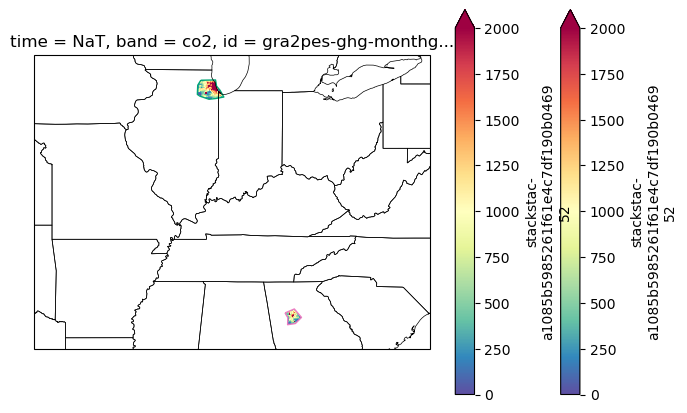

In [73]:
import cartopy.feature as cf
fig1=plt.figure(figsize=(8,5))
ax1 = fig1.add_subplot(projection=ccrs.PlateCarree())
p1 = clip1.sel(band=band)[9,:,:].plot(vmin=vmin,vmax=vmax,cmap=cmap,ax=ax1)
p2 = clip2.sel(band=band)[9,:,:].plot(vmin=vmin,vmax=vmax,cmap=cmap,ax=ax1)
aoi1.plot(ax=ax1,edgecolor=color1,linewidth=1,facecolor='none')
aoi2.plot(ax=ax1,edgecolor=color2, linewidth=1,facecolor='none')
ax1.set_xlim(-95.4,-78.5)
ax1.set_ylim(32.6,43.04)
ax1.add_feature(cf.STATES,linewidth=0.5)

<h2>Calculate and apply area weights for lat/lon grid cells</h2>

Emissions are in `tons km-2 month-1`, but our grid cells are in lat/lon space - calculate how many km are in each grid cell, so we can calculate `tons month-1` for each AOI.

In [74]:
# This function returns m2, and we need km2. Note the /1000./1000.
weights1 = surfaceAreaGrid.surfaceAreaGridd(lat_centers=clip1.y.values, \
    lon_centers=clip1.x.values,ret_area=True)/1000./1000.
weights2 = surfaceAreaGrid.surfaceAreaGridd(lat_centers=clip2.y.values,\
    lon_centers=clip2.x.values,ret_area=True)/1000./1000.                   

In [75]:
# Apply these weights - simple as a multiplication
clip1_weighted = clip1.sel(band=band)*weights1
clip2_weighted = clip2.sel(band=band)*weights2

In [76]:
# Take the mean of emissions over AOI grid cells
clip1_means = clip1_weighted.mean(dim=['x','y'])
clip2_means = clip2_weighted.mean(dim=['x','y'])

In [77]:
# Reformat some times for plotting purposes
times = [sd[0:10] for sd in clip1_means.start_datetime.values]
times = [datetime.datetime.strptime(sd,'%Y-%m-%d').strftime('%b') for sd in times]

<h3>Plot emissions time series for 2021</h3>

Text(0.5, 1.0, 'Mean urban co2 emissions from GRA2PES, 2021')

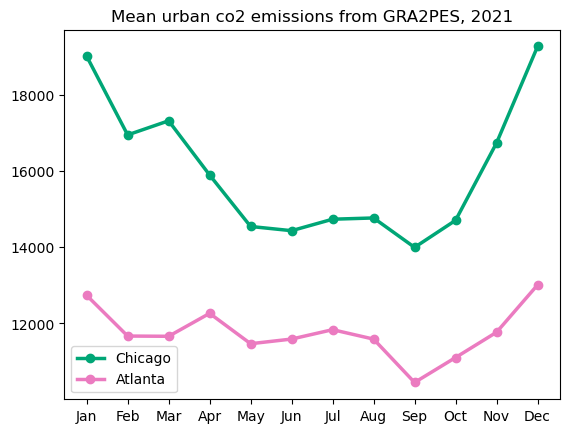

In [78]:
fig,ax1 = plt.subplots()
ax1.plot(times[::-1],clip1_means.values[::-1],marker='o',color=color1,label=name1,lw=2.5)
ax1.plot(times[::-1],clip2_means.values[::-1],marker='o',color=color2,label=name2,lw=2.5)
#ax2.set_ylabel('Urban',color=urban_color,fontweight='bold')
plt.legend()
plt.title(f'Mean urban {band} emissions from GRA2PES, 2021')

<h4>Apart from their magnitudes, what other differences do you notice between the CO2 seasonal cycles for these two cities? What might explain these differences? Do think these difference are consistent across other cities, or other GHGs?</h4>

#### Follow-up question: Do this same comparison between an urban area and a rural area. How might you understand those differences?